In [1]:
import json
import os
import numpy as np
import pandas as pd
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import plotly.express as px
from pathlib import Path
from collections import Counter
import itertools
from PIL import Image, ImageOps
import dask.bag as db
from dask.diagnostics import ProgressBar
import nltk
from wordcloud import WordCloud, STOPWORDS

import networkx as nx
from networkx.algorithms import bipartite
from pyvis.network import Network
from sklearn.preprocessing import MinMaxScaler

import warnings
warnings.filterwarnings("ignore")

plt.rcParams["font.family"] = 'Segoe UI'
%matplotlib inline

In [2]:
def filter_by_category_and_year(record, categories, year):
    """
    Filters the record based on the given categories and year. 
    Returns True if the record falls within the selected categories and is 
    more recent than the provided year. 
    """
    if any(category in record['categories'] for category in categories):
        latest_version_year = int(
            record['versions'][-1]['created'].split(" ")[3])
        if year is None or latest_version_year >= year:
            return True
    return False



def get_metadata(record):
    """
    Extracts the metadata from a record, including ID, title, category, 
    abstract, version, doi, and parsed authors. 
    """
    return {'id': record['id'],
            'title': record['title'],
            'category': record['categories'],
            'abstract': record['abstract'],
            'version': record['versions'][-1]['created'],
            'doi': record['doi'],
            'authors_parsed': record['authors_parsed']
            }

def create_authors_field(data):
    """
    Creates a dedicated 'authors' field from parsed author data in the dataset. 
    """
    data['authors'] = data['authors_parsed'].apply(
        lambda authors: [(" ".join(author)).strip() for author in authors]
    )
    return data


def create_author_pairs(row):
    """
    Creates pairs of authors who have collaborated on a paper. 
    """
    authors_list = list(set(row['authors']))
    pairs = list(itertools.combinations(authors_list, 2))
    return pairs


def extractArxivData(categories=['cs.AI'], year=None, 
                     raw_data_path="../data/raw/",
                     save_extracted_filename="../data/processed/AI.parquet"):
    """
    Function to extract, read raw records, filter them, extract  metadata, 
    create author fields and creates author pairs. 
    Saves the processed data as a JSON file. 
    """
    try:
        records = db.read_text(raw_data_path + "/").map(json.loads)

        with ProgressBar():
            filtered_records = records.filter(
                lambda x: filter_by_category_and_year(x, categories, year))
            metadata = filtered_records.map(
                get_metadata).to_dataframe().compute()

        processed_data = create_authors_field(metadata)

        # Create author pairs for coauthorship
        processed_data['author_pairs'] = processed_data.apply(
            create_author_pairs, axis=1)

        print(f"Number of Records Extracted for Given Set of Categories: {processed_data.shape[0]}")

        Path(os.path.dirname(save_extracted_filename)).mkdir(
            parents=True, exist_ok=True)
        processed_data.to_parquet(save_extracted_filename, compression='gzip',
                                  engine='pyarrow')

        return processed_data

    except Exception as e:
        print(f"Error occurred: {e}")
        return None

In [3]:
df = extractArxivData(categories =['cs.AI'], year=2019,
                      raw_data_path='raw_arxiv.json',
                      save_extracted_filename="AI_19_23.parquet")

[########################################] | 100% Completed |  0.4s
[########################################] | 100% Completed | 18.0s
Number of Records Extracted for Given Set of Categories: 51741


In [64]:
#df = pd.read_parquet('AI_19_23.parquet')
nodes = (pd.DataFrame.from_dict(Counter(list(itertools.chain(*df.authors.tolist()))),
                                orient='index', columns=['paper_cnt'])
         .query('paper_cnt > 9', engine='python')
         ).index.tolist()

edges = [i[0] + (i[1],) for i in 
         Counter(list(itertools.chain(*df.author_pairs.tolist()))).items()]

# All nodes/authors
G1 = nx.Graph()
G1.add_weighted_edges_from(edges)
print(f'OG Nodes: {len(G1.nodes())}')
print(f'No. of edges: {len(G1.edges())}\n')

# Only nodes/authors with at least 10 papers
G = nx.Graph(nx.subgraph(G1, nodes))
print(f'Nodes/authors with at least 10 published papers: {len(G.nodes())}')
print(f'No. of edges: {len(G.edges())}\n')

G.remove_nodes_from(list(nx.isolates(G)))
        
print(f'No. of non-isolated nodes with coauthored paper of at least 10: {len(G.nodes)}')
print(f'No. of edges: {len(G.edges())}\n')

# Get the connected components
connected_components = nx.connected_components(G)

# Find the largest connected component
largest_connected_component = max(connected_components, key=len)

# Now, create a subgraph of G consisting only of nodes in largest connected component
LG = G.subgraph(largest_connected_component)

print(f'No. of nodes (non-isolated) in largest connected component: {len(LG.nodes)}')
print(f'No. of edges in largest connected component:: {len(LG.edges())}')

OG Nodes: 106832
No. of edges: 741802

Nodes/authors with at least 10 published papers: 2722
No. of edges: 20610

No. of non-isolated nodes with coauthored paper of at least 10: 2656
No. of edges: 20610

No. of nodes (non-isolated) in largest connected component: 2627
No. of edges in largest connected component:: 20594


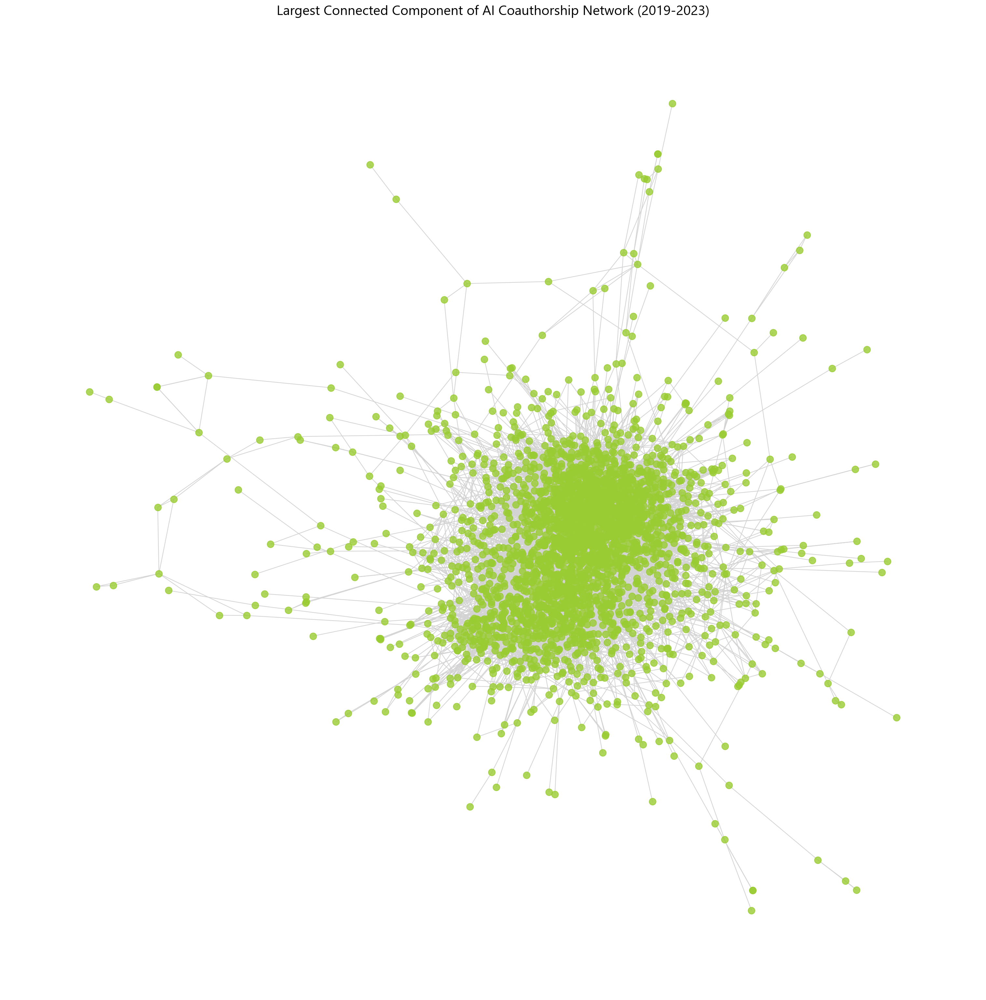

In [43]:
plt.figure(figsize=(20, 20), dpi=150)
pos = nx.fruchterman_reingold_layout(LG, seed=42)  
nx.draw(LG, pos, node_color=[(0.6, 0.8, 0.196,0.8)], node_size=100,
        edge_color='lightgray')
plt.title('Largest Connected Component of AI Coauthorship Network (2019-2023)',
          fontsize=20)
plt.savefig('assets/LCC.png', dpi=200, bbox_inches='tight')
plt.show()

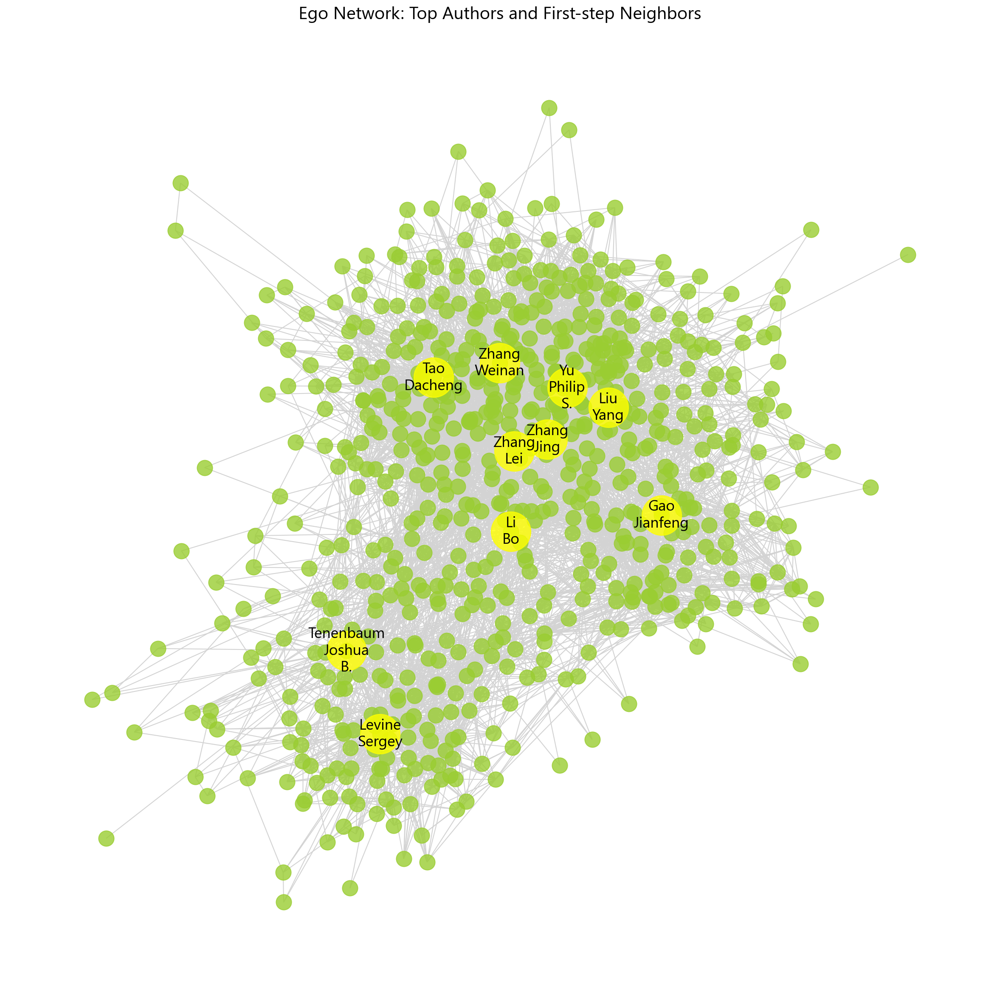

No. of nodes (non-isolated) in largest connected component: 708
No. of edges in largest connected component:: 6337


In [51]:
# Get the top N authors with the most collaborations
N = 10
top_authors = [node for node, deg in sorted(nx.degree(LG), key=lambda x: x[1], reverse=True)[:N]]

# Get the first-step neighbors of these top authors
neighbors = {nbr for author in top_authors for nbr in LG.neighbors(author)}

# Create the subgraph
sub_LG = LG.subgraph(top_authors + list(neighbors))
labels = {node: node.replace(' ','\n') for node in sub_LG.nodes() if node in top_authors}

plt.figure(figsize=(20, 20), dpi=150)
pos = nx.fruchterman_reingold_layout(sub_LG, seed=42)

# Draw all nodes with one color and size
nx.draw_networkx_nodes(sub_LG, pos, node_color='yellowgreen', alpha=0.8, node_size=300)
nx.draw_networkx_nodes(sub_LG, pos, nodelist=top_authors, node_color='yellow', alpha=0.8, node_size=2000)
nx.draw_networkx_edges(sub_LG, pos, edge_color='lightgray')
nx.draw_networkx_labels(sub_LG, pos, labels=labels, font_size=17, font_family='Segoe UI')

plt.title('Ego Network: Top Authors and First-step Neighbors', fontsize=20)
plt.axis('off')
plt.savefig('assets/SLG.png', dpi=200, bbox_inches='tight')
plt.show()

print(f'No. of nodes (non-isolated) in largest connected component: {len(sub_LG.nodes)}')
print(f'No. of edges in largest connected component:: {len(sub_LG.edges())}')


In [10]:
def nx_props(G, clr, save=True):
    # Check if directed/undirected or bipartite
    diG = 'Yes' if G.is_directed() else 'No'
    biG = 'Yes' if bipartite.is_bipartite(G) else 'No'
    print(f'Is the graph directed? {diG}')
    print(f'Is the graph bipartite? {biG}\n')

    if biG == 'Yes':
        print("Warning: The graph is bipartite. Some centrality measures may not be applicable.\n")

    # No. of nodes and edges
    N = G.order()
    L = G.size()
    print (f'Total No. of Nodes: {N}')
    print (f'Total No. of Edges: {L}\n')

    # Graph density
    print("Graph density: ", round(nx.density(G),4))

    # Degrees
    avg_deg = float(L) / N
    print ('Average degree: ', avg_deg)

    d_deg = dict(nx.degree(G))
    deg = [k for node, k in d_deg.items()]

    plt.hist(deg, bins=len(set(deg)), width=0.8, color=clr)
    plt.title('Degree Distribution of the Network')
    plt.show()

    df_metrics = pd.DataFrame.from_dict(dict(nx.degree(G)), orient='index', columns=['degree'])

    # Degree centrality
    df_metrics['degree_centrality'] = pd.Series(nx.degree_centrality(G))

    # In-degree and Out-degree centrality for directed graphs
    if diG == 'Yes':
        df_metrics['in_degree_centrality'] = pd.Series(nx.in_degree_centrality(G))
        df_metrics['out_degree_centrality'] = pd.Series(nx.out_degree_centrality(G))

    # Betweenness centrality
    df_metrics['betweenness_centrality'] = pd.Series(nx.betweenness_centrality(G))

    # Closeness centrality
    df_metrics['closeness_centrality'] = pd.Series(nx.closeness_centrality(G))

    # Eigenvector centrality
    try:
        df_metrics['eigenvector_centrality'] = pd.Series(nx.eigenvector_centrality(G, max_iter=1000))
    except nx.PowerIterationFailedConvergence:
        print("\nWarning: Eigenvector centrality computation did not converge. Skipping this metric.")
    
    # PageRank
    df_metrics['pagerank'] = pd.Series(nx.pagerank(G))

    # Clustering coefficient
    df_metrics['clustering_coefficient'] = pd.Series(nx.clustering(G))
    
    if save:
        df_metrics.to_parquet('df_nx_props.parquet', compression='gzip', engine='pyarrow')

    return df_metrics

Is the graph directed? No
Is the graph bipartite? No

Total No. of Nodes: 708
Total No. of Edges: 6337

Graph density:  0.0253
Average degree:  8.950564971751412


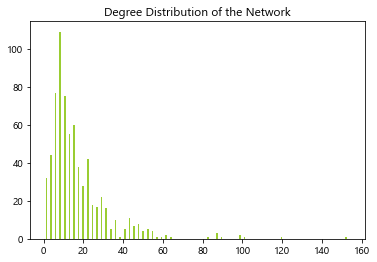

,degree,degree_centrality,betweenness_centrality,closeness_centrality,eigenvector_centrality,pagerank,clustering_coefficient
Fergus Rob,8,0.011315,0.000394,0.329297,0.000389,0.000732,0.285714
Qin Yujia,48,0.067893,0.001040,0.414906,0.149129,0.003163,0.773936
Xiao Ted,16,0.022631,0.000180,0.345383,0.000786,0.001850,0.800000
Shen Yikang,10,0.014144,0.000801,0.357251,0.002552,0.001325,0.377778
Sun Hao,56,0.079208,0.006366,0.425647,0.148350,0.002850,0.560390
Yang Guang,39,0.055163,0.003223,0.414663,0.042167,0.001671,0.577598
Ray Baishakhi,2,0.002829,0.000021,0.343704,0.004181,0.000286,0.000000
Yu Zhou,62,0.087694,0.012301,0.442705,0.148663,0.002796,0.472237
Lan Yanyan,32,0.045262,0.001450,0.386128,0.055130,0.001437,0.495968
Wang Cunxiang,13,0.018388,0.000131,0.359431,0.004106,0.000954,0.769231


In [11]:
df_metrics = nx_props(sub_LG, 'yellowgreen')
df_metrics.head(10)

In [94]:
def draw_centrality_subplots(G, df_metrics, edge_alpha=0.15, node_alpha=0.7, save=True):
    """
    Function to draw subplots based on centrality measures: Degree, Betweenness,
    Closeness, Eigenvector, Pagerank, and Clustering Coefficient. Nodes are labeled if their centrality measure 
    is greater than the provided label threshold. Opacity of edges and nodes can be set.
    
    Parameters:
    - G: A NetworkX graph
    - df_metrics: DataFrame containing the centrality measures for the nodes
    - edge_alpha: Opacity for edges
    - node_alpha: Opacity for node colors
    """
    
    # Getting the nodes and their measures
    nodes = df_metrics.index
    measures = ['degree_centrality', 'betweenness_centrality', 'closeness_centrality', 'eigenvector_centrality']
    
    # Compute the positions only once for consistency across subplots
    pos = nx.spring_layout(G, seed=42)  
    
    # Create a colormap with transparency
    cmap = plt.cm.summer
    cmaplist = [cmap(i) for i in range(cmap.N)]
    for i in range(cmap.N):
        cmaplist[i] = list(cmaplist[i])
        cmaplist[i][3] = node_alpha  # Set alpha
    cmap_with_alpha = mcolors.LinearSegmentedColormap.from_list('Custom cmap', cmaplist, cmap.N)
    
    fig, axes = plt.subplots(4, 1, figsize=(10, 70), dpi=150)
    #fig.delaxes(axes.flatten()[-1])
    
    # Create a ScalarMappable object for the colorbar
    sm = cm.ScalarMappable(cmap=cmap_with_alpha, norm=plt.Normalize(vmin=0, vmax=1))
    
    for i, measure in enumerate(measures):
        ax = axes[i]
        centrality = df_metrics[measure]
        
        # Normalizing the centrality measures for visualization
        centrality_norm = (centrality - min(centrality)) / (max(centrality) - min(centrality))
        
        # Creating a dictionary of node sizes for each measure
        sizes = dict(zip(nodes, centrality_norm*1000))
        
        # Identifying the nodes to label
        labels = {node: node for node in G.nodes() if centrality[node] > np.percentile(centrality, 99)}
        
        # Adding node colors based on centrality
        colors = [centrality_norm[n] for n in G.nodes()]
        
        nx.draw_networkx_edges(G, pos, edge_color='lightgray', ax=ax)
        nx.draw_networkx_nodes(G, pos, node_size=[sizes[node] for node in G.nodes()], 
                               node_color=colors, cmap=cmap_with_alpha, ax=ax)
        

        nx.draw_networkx_labels(G, pos, labels=labels, font_size=20, ax=ax, 
                                font_color='k', font_family='Segoe UI')
        
        ax.set_title(measure.capitalize().replace("_", " "), fontsize=30, y=0.93)
        ax.axis('off')
    
    # Adjust spaces
    plt.subplots_adjust(wspace=-0.02, hspace=-0.08)

    # Add the colorbar to the figure
    cbar_ax = fig.add_axes([0.9, 0.15, 0.02, 0.7])
    cbar = fig.colorbar(sm, cax=cbar_ax)
    cbar.ax.tick_params(labelsize=25)  # Increase tick size
    
    if save:
        # Save the figure with high DPI
        plt.savefig('assets/SLG_centralities2.png', dpi=300, bbox_inches='tight')
    
    plt.show()


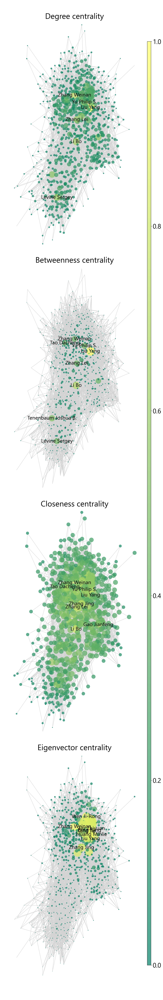

In [95]:
draw_centrality_subplots(sub_LG, df_metrics=df_metrics, save=False)

In [33]:
for i in ['degree_centrality', 'betweenness_centrality', 
          'closeness_centrality', 'eigenvector_centrality', 
          'pagerank']:
    cent = i.replace('_',' ').capitalize()
    print(f'Top Nodes/Authors by {cent}')
    display(df_metrics.sort_values(i, ascending=False).head(5)[[i]])
    print('\n')

Top Nodes/Authors by Degree centrality


,degree_centrality
Liu Yang,0.217822
Zhang Weinan,0.169731
Li Bo,0.144272
Yu Philip S.,0.141443
Levine Sergey,0.140028




Top Nodes/Authors by Betweenness centrality


,betweenness_centrality
Liu Yang,0.125298
Li Bo,0.090152
Tenenbaum Joshua B.,0.064738
Yu Philip S.,0.058837
Levine Sergey,0.057948




Top Nodes/Authors by Closeness centrality


,closeness_centrality
Liu Yang,0.506447
Li Bo,0.476094
Tao Dacheng,0.463911
Zhang Weinan,0.461790
Zhang Jing,0.459091




Top Nodes/Authors by Eigenvector centrality


,eigenvector_centrality
Liu Yang,0.171930
Zhang Weinan,0.167044
Wen Ji-Rong,0.156025
Zhang Jing,0.156010
Ding Ning,0.155444




Top Nodes/Authors by Pagerank


,pagerank
Liu Yang,0.010707
Levine Sergey,0.010564
Tenenbaum Joshua B.,0.008556
Li Bo,0.008092
Gao Jianfeng,0.007863


In [17]:
from networkx.algorithms import community
import pandas as pd

def community_stats(G, df, save=True):
    # Initialize list to store results
    stats = []

    # Get partition with louvain method
    partition = nx.community.louvain_communities(G, seed=1999, resolution=0.35)
    
    for community_nr, community in enumerate(partition):
        for node in community:
            G.nodes[node]["community"] = community_nr
    
    df_com = df[['id','title','abstract','authors']].explode('authors')
    df_com["community"] = (df_com["authors"].map({k: v['community'] 
                                                  for k,v in 
                                                  dict(G.nodes(data=True)).items()})
                          )
    df_temp = df_com.dropna(subset=['community']).groupby('community').authors.nunique().reset_index()
    df_com = (df_com.dropna(subset=['community'])
              .drop(columns=['authors'])
              .drop_duplicates()
              .reset_index(drop=True)
             )

    # Iterate over each community in the partition
    for idx, community in enumerate(partition):
        # Create a subgraph for this community
        subgraph = G.subgraph(community)

        # Calculate metrics
        density = nx.density(subgraph)
        avg_clustering = nx.average_clustering(subgraph)
        volume = sum([G.degree(v) for v in community])
        cut = sum([1 for v in community for w in G.neighbors(v) if w not in community])
        conductance = cut / volume if volume > 0 else 0

        # Append results
        stats.append({
            'Community': idx, 
            'Density': density, 
            'Average Clustering': avg_clustering, 
            'Conductance': conductance})

    # Convert list of dicts to DataFrame
    df_com_stats = pd.DataFrame(stats).merge(df_temp, left_on='Community', right_on='community')
    
    if save:
        import pickle
        
        # save graph object to file
        pickle.dump(sub_LG, open('SLG.pickle', 'wb'))
        df_com.to_parquet('df_com.parquet', compression='gzip', engine='pyarrow')
        df_com_stats.to_parquet('df_com_stats.parquet', compression='gzip', engine='pyarrow')

    return df_com, df_com_stats

In [89]:
from PIL import Image, ImageOps

def clean_and_parse(text):
    # A list of words to ignore
    stop_words = set(list(STOPWORDS) + ['different', 'performance', 'method',
                                        'task', 'model', 'feature', 'problem',
                                        'dataset', 'data', 'based', 'evaluation',
                                        'propose', 'algorithm', 'via', 'framework',
                                        'models', 'training', 'test', 'methods',
                                        'proposed', 'tasks', 'information',
                                        'datasets', 'approach', 'learning', 
                                        'knowledge', 'paper', 'result', 'show', 
                                        'experiment', 'shows','results',
                                        'existing', 'work', 'graph', 'network',
                                        'neural', 'networks'])

    # Tokenize the text
    words = nltk.word_tokenize(text)

    # Remove stop words and punctuation
    words = [word for word in words if word not in stop_words and word.isalpha()]

    return words

def plot_wordclouds(df, mask_image_path='robo1.png', by='title'):
    # Load the image and convert it to a numpy array
    # Try to open and convert the image
    try:
        mask_image = np.array(Image.open(mask_image_path))
    except Exception as e:
        print(f"Couldn't open or convert the image. Error: {e}")
        return
    
    fig, axs = plt.subplots(2, 2, figsize=(20, 20), dpi=200)

    # Assuming `communities_papers_df` is your DataFrame containing 'community' and 'title' columns.
    for community, subset in df.groupby("community"):
        community = int(community)
        
        # Combine all paper titles into one large string
        all_titles = " ".join(subset[by]).lower()

        # Clean and parse the titles
        words = clean_and_parse(all_titles)

        # Generate the word cloud
        wc = WordCloud(background_color='white', mask=mask_image,
                       collocations=False, colormap=plt.cm.summer,
                       contour_width=1, contour_color='steelblue').generate(" ".join(words))
        axs[community // 2, community % 2].imshow(wc, interpolation="bilinear")
        axs[community // 2, community % 2].axis('off')
        axs[community // 2, community % 2].set_title(f"Community {community}",
                                                    fontsize=20)

    plt.tight_layout()
    plt.show()

In [19]:
df_com, df_com_stats = community_stats(sub_LG, df, save=True)
df_com_stats

,Community,Density,Average Clustering,Conductance,community,authors
0,0,0.086777,0.626226,0.265746,0.0,159
1,1,0.053605,0.447688,0.149915,1.0,320
2,2,0.054558,0.493455,0.190727,2.0,206
3,3,0.584980,0.820546,0.296912,3.0,23


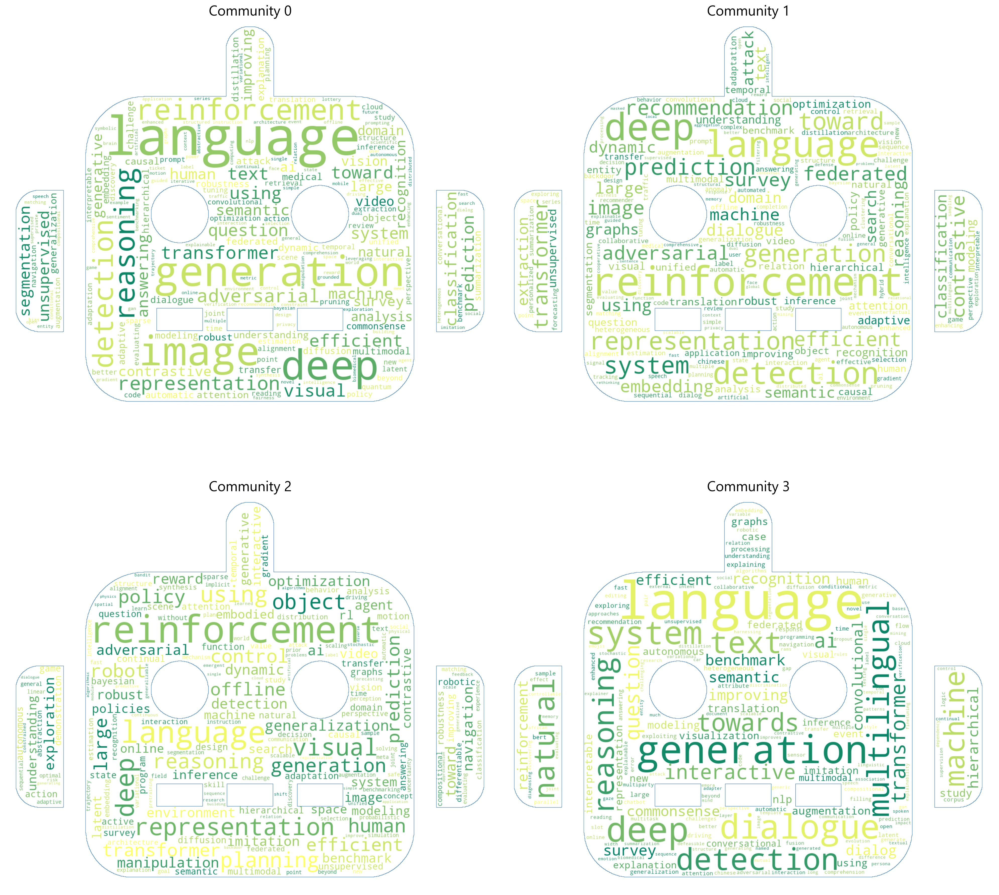

In [90]:
plot_wordclouds(df_com)

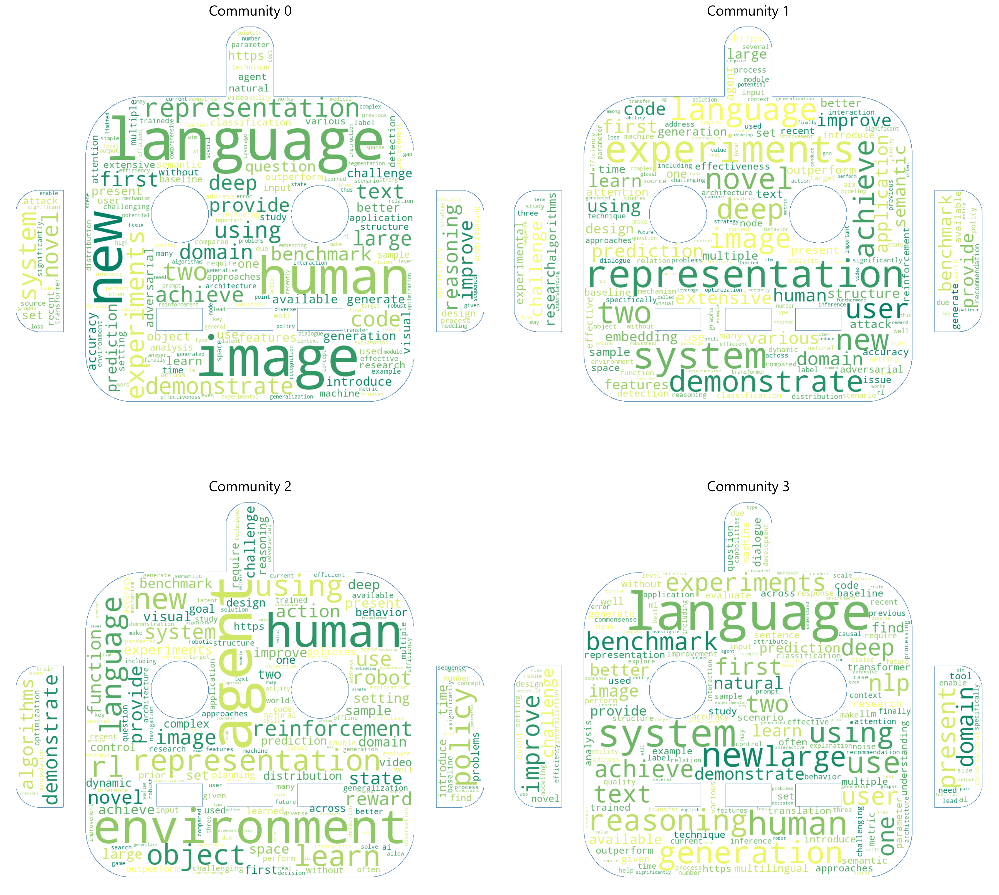

In [91]:
plot_wordclouds(df_com, by='abstract')